# Initial mRNA Visualization
Here, I perform an unbiased visualization of the mRNA data. I correct only for batch at this point. Through some exploratory analysis, we've seen a prominent effect due to mitochondrial transcripts that can't be corrected by simply remove the genes from the matrix. For now, we are planning on generating a _clean_ dataset without any of the contaminating cells.

# Setup

In [1]:
import scanpy as sc
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import warnings
import itertools as it
import json
import seaborn as sns
import pickle as pkl
from functools import reduce

from nero import Octavia
from nero import Nero as nr

In [3]:
sc.settings.verbosity = 4
sc.settings.set_figure_params(dpi=80)
sc.settings.n_jobs=30

In [4]:
mountpoint = '/data/clue/'
prefix_adts = mountpoint + 'prod/adts/'
prefix_mrna = mountpoint + 'prod/mrna/'
prefix_comb = mountpoint + 'prod/comb/'

In [5]:
Octavia.set_mountpoint('/data/clue/')

## Load in Data

In [8]:
path = prefix_mrna + 'pkls/wells_sng_covars.pkl'
    
with open(path,'rb') as file:
    wells = pkl.load(file)

### Adjust Cell Barcodes, Filter

I'm adjusting the cell barcodes to make them match their well number, which I also did with the ADTs.

In [9]:
for well in wells:
    wells[well]['adata'].obs_names = [i[:16] + '-%s' % well for i in wells[well]['adata'].obs_names]

# Processing

In [10]:
concat = wells[0]['adata'].concatenate(*[wells[i]['adata'] for  i in range(1, 12)])

In [11]:
concat.var['total_mrna_n_counts'] = concat.X.toarray().sum(axis=0)
concat.obs['mrna_n_counts'] = concat.X.toarray().sum(axis=1)

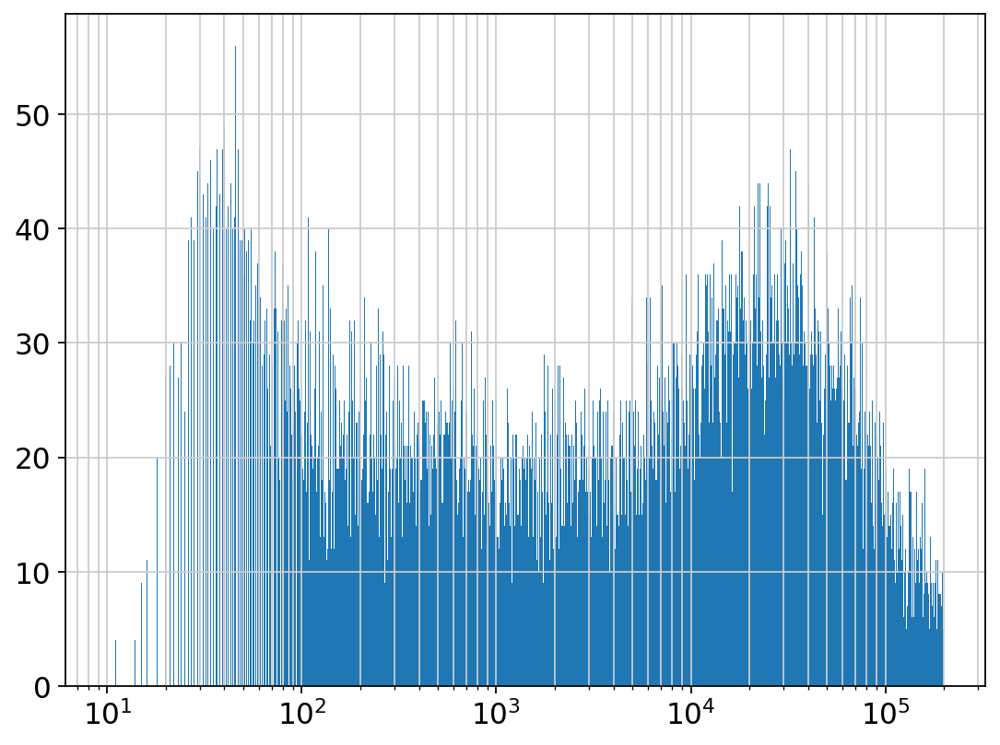

In [12]:
plt.figure(figsize=(8,6))
plt.hist(concat.var['total_mrna_n_counts'].values, bins=np.logspace(np.log10(10),np.log10(2e5), 1000))
plt.grid(False)
plt.grid(True, 'both', 'both')
plt.xscale('log')
# plt.yscale('log')

In [10]:
sc.pp.filter_genes(concat, min_counts=100, inplace=True) # keep as many genes as possible
sc.pp.normalize_per_cell(concat, counts_per_cell_after=1e6)
sc.pp.log1p(concat)
sc.pp.scale(concat)
sc.pp.combat(concat, key='batch', covariates=['cond','free_id'])
sc.pp.scale(concat)
sc.pp.pca(concat, n_comps=200)

filtered out 2761 genes that are detected in less than 100 counts
normalizing by total count per cell
    finished (0:00:03): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


... storing 'DROPLET.TYPE' as categorical
... storing 'free_id' as categorical
... storing 'exp_id' as categorical
... storing 'pool_code' as categorical
... storing 'cond' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


Standardizing Data across genes.

Found 12 batches

Found 2 categorical variables:
	cond, free_id

Found 0 numerical variables:
	

Fitting L/S model and finding priors

Finding parametric adjustments

Adjusting data

computing PCA
    with n_comps=200
    finished (0:10:21)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


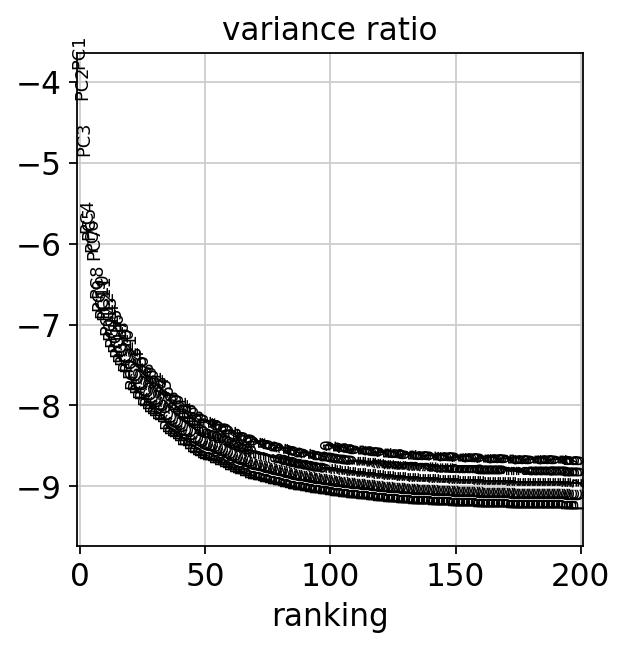

In [11]:
sc.pl.pca_variance_ratio(concat, log=True, n_pcs=200)

In [ ]:
# warnings.filterwarnings('ignore')
sc.pp.neighbors(concat, n_neighbors=15, n_pcs=175)
# warnings.filterwarnings('default')

In [13]:
sc.tl.umap(concat)

computing UMAP
	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:04:23)


Leiden clustering should usually only take a few minutes, even with a big dataset. Unfortunately, since I have switched to a new instance on AWS, I installed the latest version of scanpy, which was working seamelessly with the objects I created in an older version until this happened. Now leiden clustering is taking forever, and I'm not sure if it's just because I'm not waiting long enough or if its something else internally happening. I should figure this out before this notebook gets pubslished.

In [7]:
sc.tl.leiden(concat, resolution=0.5)

running Leiden clustering
    finished: found 23 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:01:49)


# Initial Visualization

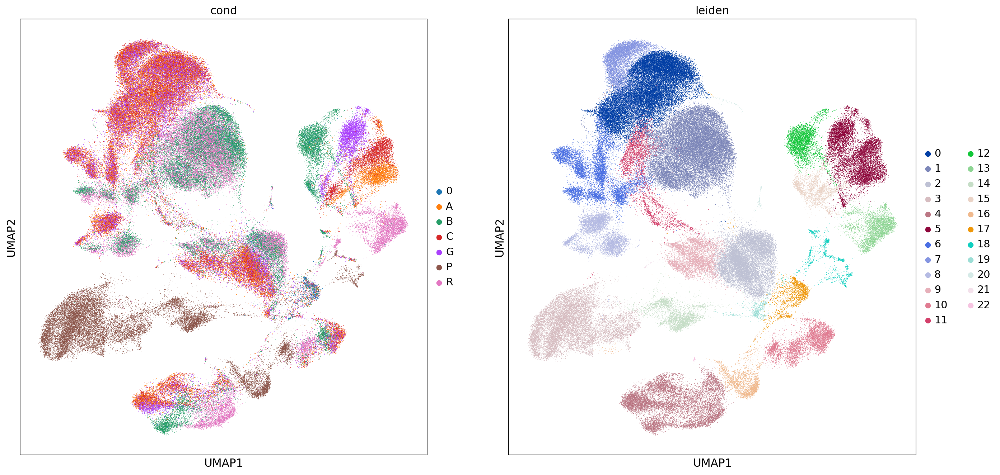

In [6]:
fig, ax = plt.subplots(1, 2, figsize=(20,10))
for color, ax, palette in zip(['cond', 'leiden'], ax, [sc.pl.palettes.default_20, sc.pl.palettes.default_28]):
    sc.pl.umap(concat, color=color, ax=ax, show=False, return_fig=False, size=2, palette=palette)

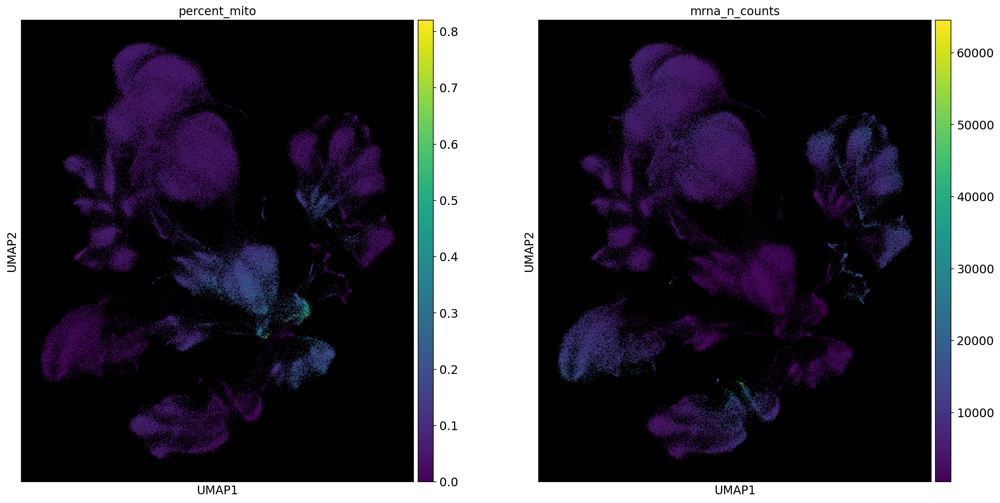

In [6]:
fig, ax = plt.subplots(1, 2, figsize=(20,10))
for color, ax in zip(['percent_mito', 'mrna_n_counts'], ax):
    ax.set_facecolor('black')
    sc.pl.umap(concat,color=color, ax=ax, show=False, return_fig=False, size=2)

Here we see the prominent effect due to percent mitochondrial content. We also see some effects due to number of transcripts in the B cells, monocytes, and PMA/I cells.

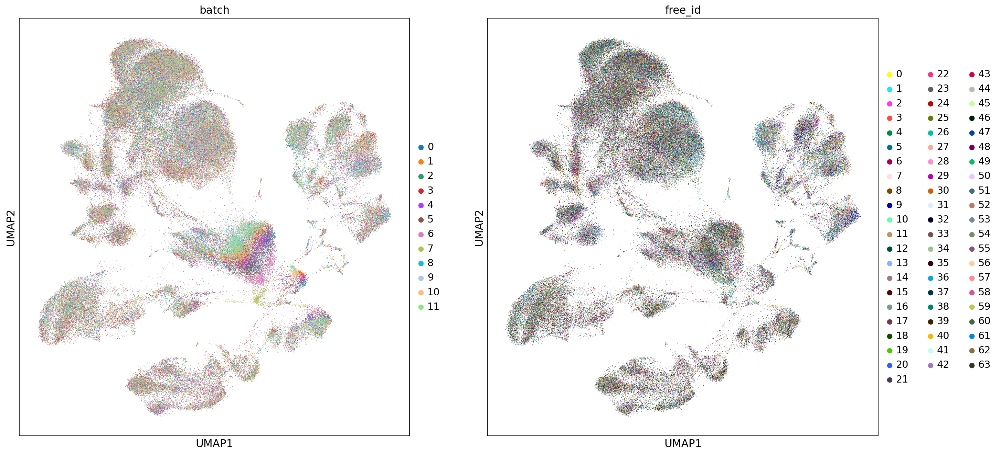

In [7]:
fig, ax = plt.subplots(1, 2, figsize=(20,10))
for color, ax in zip(['batch', 'free_id'], ax):
    sc.pl.umap(concat,color=color, ax=ax, show=False, return_fig=False, size=2)

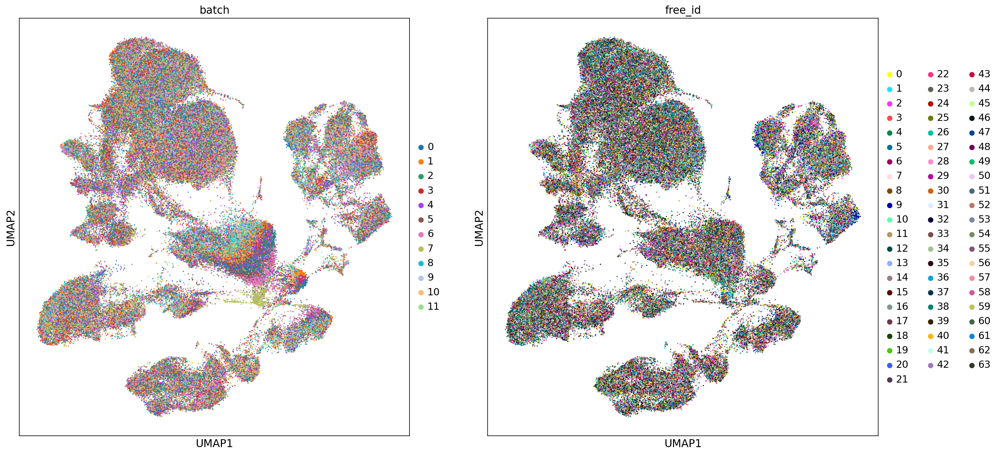

In [8]:
fig, ax = plt.subplots(1, 2, figsize=(20,10))
for color, ax in zip(['batch', 'free_id'], ax):
    sc.pl.umap(concat[np.random.choice(concat.obs_names.values, replace=False, size=len(concat.obs_names.values)),:],
               color=color, ax=ax, show=False, return_fig=False, size=10)

The batch correction does not seem to work on the high-mitochondrail content cells.

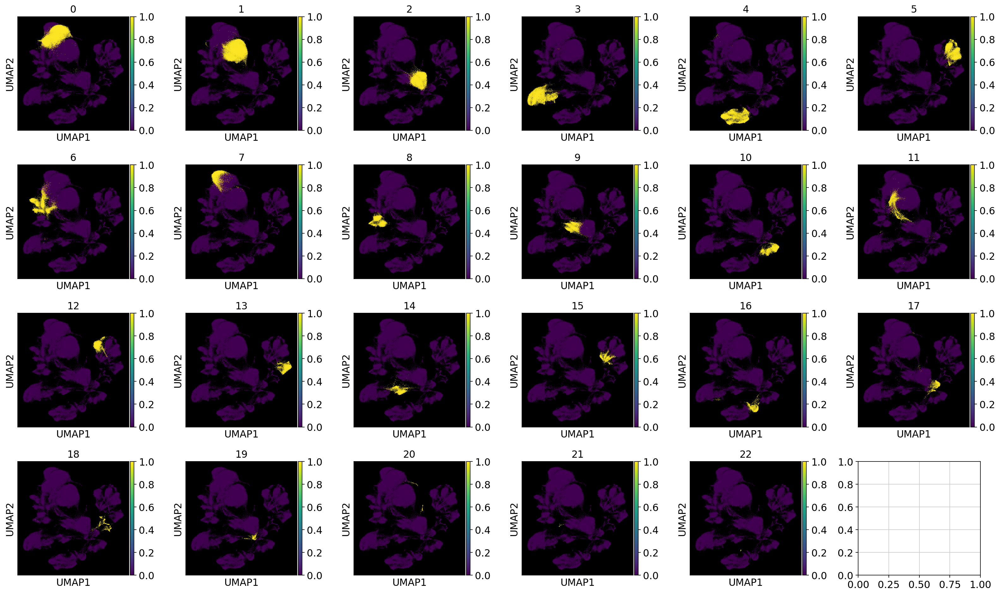

In [9]:
fig, ax = plt.subplots(4,6,figsize=(20,12))
for val, ax in tqdm(zip(concat.obs['leiden'].dtype.categories, np.ravel(ax))):
    concat.obs['val'] = concat.obs['leiden'] == val
    ax.set_facecolor('black')
    sc.pl.umap(concat,color='val', ax=ax, show=False, return_fig=False, title=val)
    concat.obs.drop(columns='val', inplace=True)
plt.tight_layout()

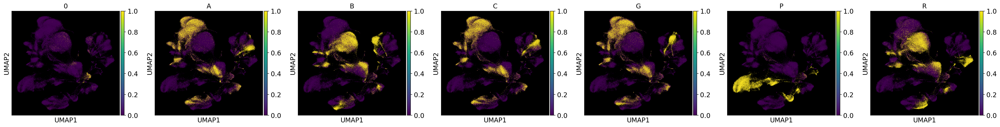

In [10]:
fig, ax = plt.subplots(1,7, figsize=(30,4))
for val, ax in tqdm(zip(concat.obs['cond'].dtype.categories, np.ravel(ax))):
    concat.obs['val'] = concat.obs['cond'] == val
    ax.set_facecolor('black')
    sc.pl.umap(concat,color='val', ax=ax, show=False, return_fig=False, title=val)
    concat.obs.drop(columns='val', inplace=True)
plt.tight_layout()

# Intermediate Export

In [6]:
path = prefix_mrna + 'h5ads/concat_0.h5ad'

# concat.write_h5ad(path)
concat = sc.read_h5ad(path)

At this point, I also export the cell barcodes by themselves to create `concat_bcs.txt`, which I then load into `export_adts_raw.ipynb` which is used to subset the ADTs to create `concat_adts.pkl`. This `.pkl` is then used by `nero.Octavia` to add raw protein data in various notebooks including this one (just below).

In [8]:
# with open(prefix_mrna + 'vals/concat_bcs.txt', 'w') as file:
#     for bc in concat.obs_names:
#         file.write(bc + '\n')

# Add Raw Data

In [ ]:
raw_mrna = Octavia.get_raw_mrna(concat.obs_names).copy()

In [ ]:
raw_adts = get_raw_adts(concat.obs_names).copy()

In [ ]:
raw = raw_mrna.T.concatenate(raw_adts.T).T
raw.var_names = [i[:-2] for i in raw.var_names]

In [ ]:
concat.raw = raw

# Visualize Features

In [15]:
proteins = [i for i in concat.raw.var_names if '|' in i]
transcripts = [i for i in concat.raw.var_names if '|' not in i]
all_features = proteins + transcripts

In [17]:
features = ['CD3E', 'CD3|CD3E', 'CD4|CD4', 'CD4', 'CD8|CD8A', 'CD8A', 
            'CD56|NCAM1', 'NCAM1', 'CD14|CD14', 'CD14', 'CD16|FCGR3A','FCGR3A',
            'CD20|MS4A1', 'MS4A1', 'CD19', 'CD226|CD226', 'CD226', 'CD235a_b|GYPA_GYPB',
            'CLEC4C', 'CD123|IL3RA', 'CD103|ITGAE', 'ITGAE', 'MZB1', 'JCHAIN'
           ]

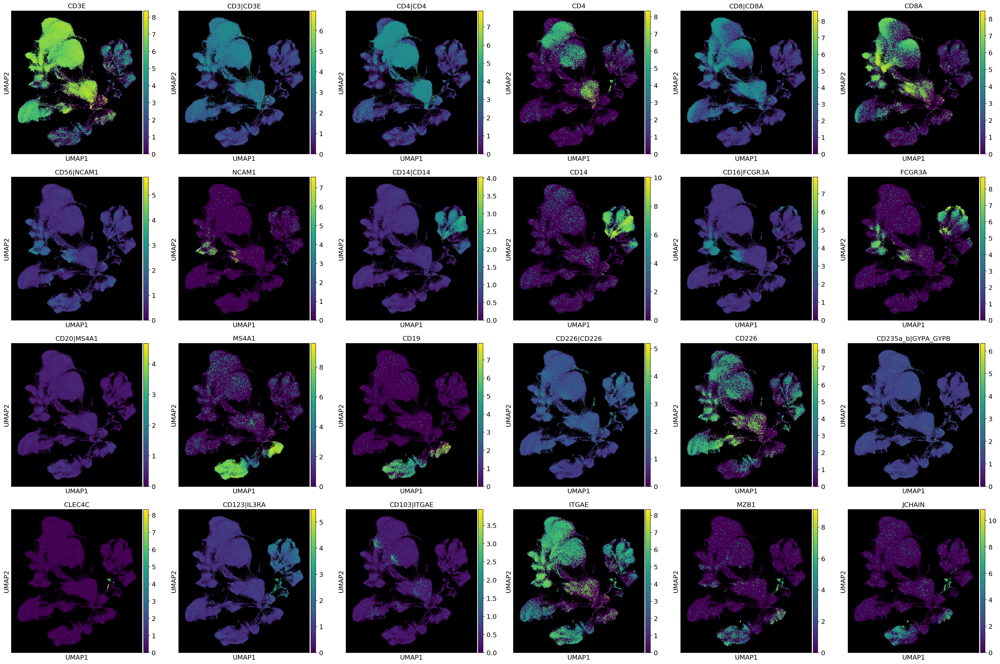

In [39]:
fig, ax = plt.subplots(4, 6, figsize=(30, 20))
for ax, f in tqdm(zip(np.ravel(ax), features)):
    ax.set_facecolor('black')
    sc.pl.umap(concat, color=f, ax=ax,show=False, return_fig=False, size=5, use_raw=True)
plt.tight_layout()

# Effects Due to Cell Number

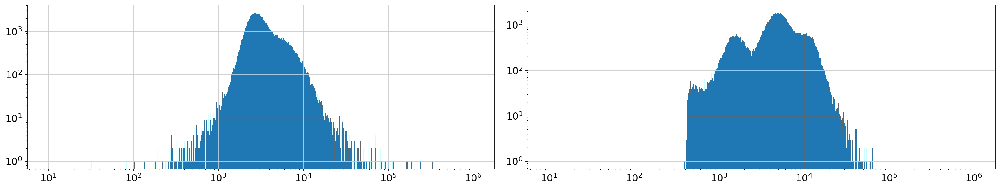

In [18]:
fig, ax = plt.subplots(1, 2, figsize=(20, 4))
for f, ax in tqdm(zip(['adts_n_counts','mrna_n_counts'], ax)):
    ax.hist(concat.obs[f].values, bins=np.logspace(np.log10(10),np.log10(1e6), 1000))
    ax.set_xscale('log')
    ax.set_yscale('log')
plt.tight_layout()

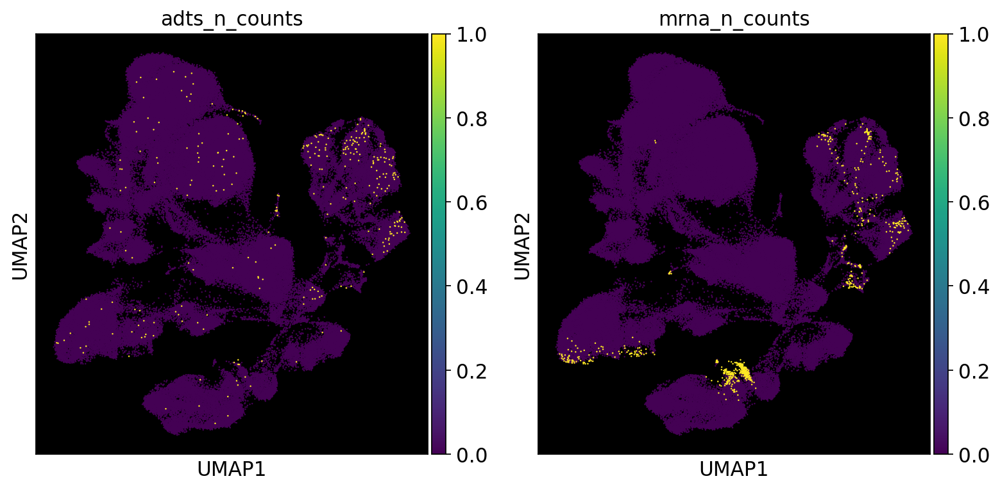

In [16]:
fig, ax = plt.subplots(1,2, figsize=(10,5))
for val, thresh, ax in tqdm(zip(['adts_n_counts', 'mrna_n_counts'], [2e4, 2e4], ax)):
    concat.obs['val'] = concat.obs[val] > thresh
    ax.set_facecolor('black')
    sc.pl.umap(concat,color='val', ax=ax, show=False, return_fig=False, title=val, size=5)
    concat.obs.drop(columns='val', inplace=True)
plt.tight_layout()

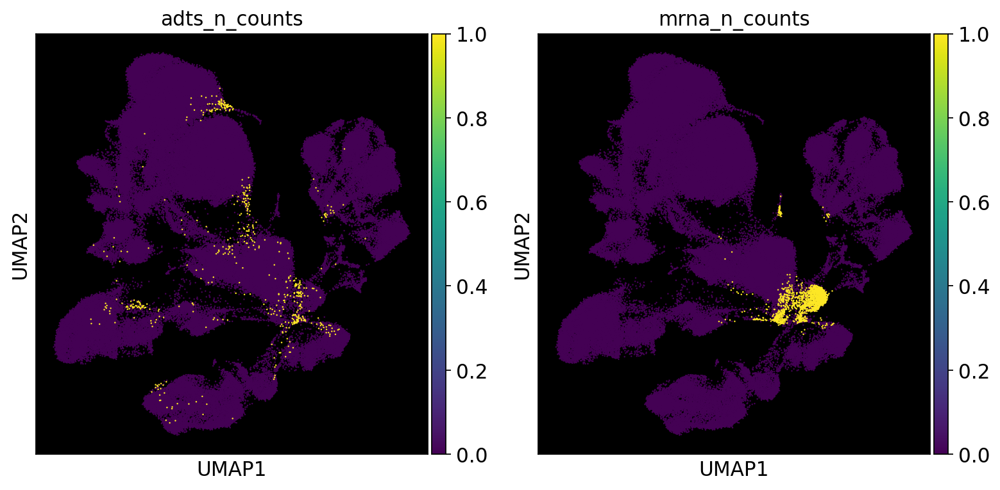

In [17]:
fig, ax = plt.subplots(1,2, figsize=(10,5))
for val, thresh, ax in tqdm(zip(['adts_n_counts', 'mrna_n_counts'], [1000, 700], ax)):
    concat.obs['val'] = concat.obs[val] < thresh
    ax.set_facecolor('black')
    sc.pl.umap(concat,color='val', ax=ax, show=False, return_fig=False, title=val, size=5)
    concat.obs.drop(columns='val', inplace=True)
plt.tight_layout()

We see that those cells that are stretching from each monocyte population have higher counts, as do those B cells stretching towards the center of the UMAP. These cells actually *seem* to have some shared markers with T cells but are specifically expressing some markers very highly. I don't think these are artifactual or doublets, but rather some activation state.  

In [19]:
features = ['CALCRL', 'TVP23A', 'CRLF2',
            'CD1C', 'CCL22', 'NPW'
           ]

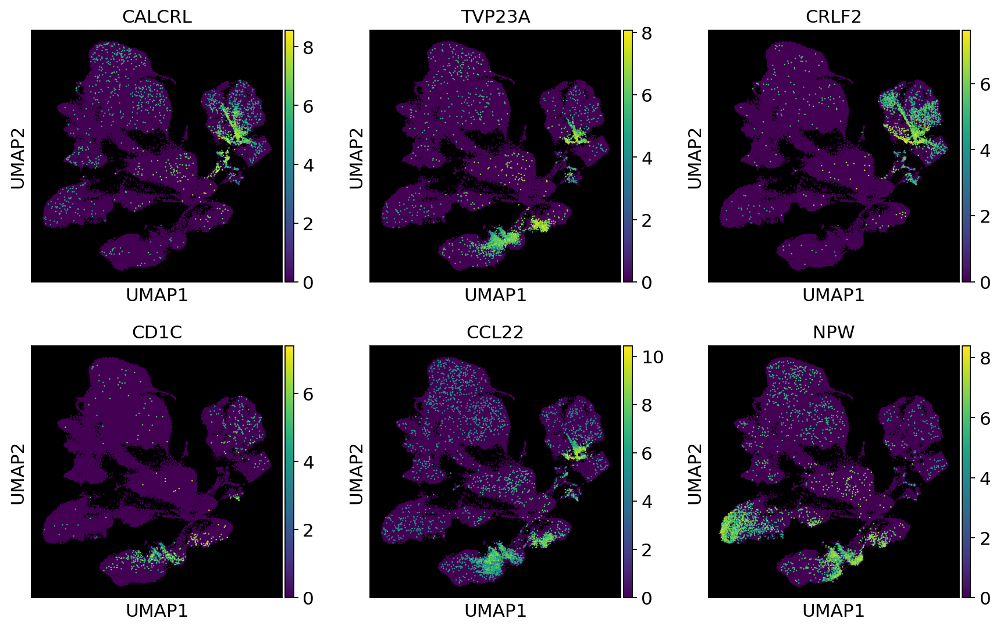

In [225]:
fig, ax = plt.subplots(2, 3, figsize=(11, 7))
for ax, f in tqdm(zip(np.ravel(ax), features)):
    ax.set_facecolor('black')
    sc.pl.umap(concat, color=f, ax=ax,show=False, return_fig=False, size=5, use_raw=True)
plt.tight_layout()

# Grouping and Subclustering

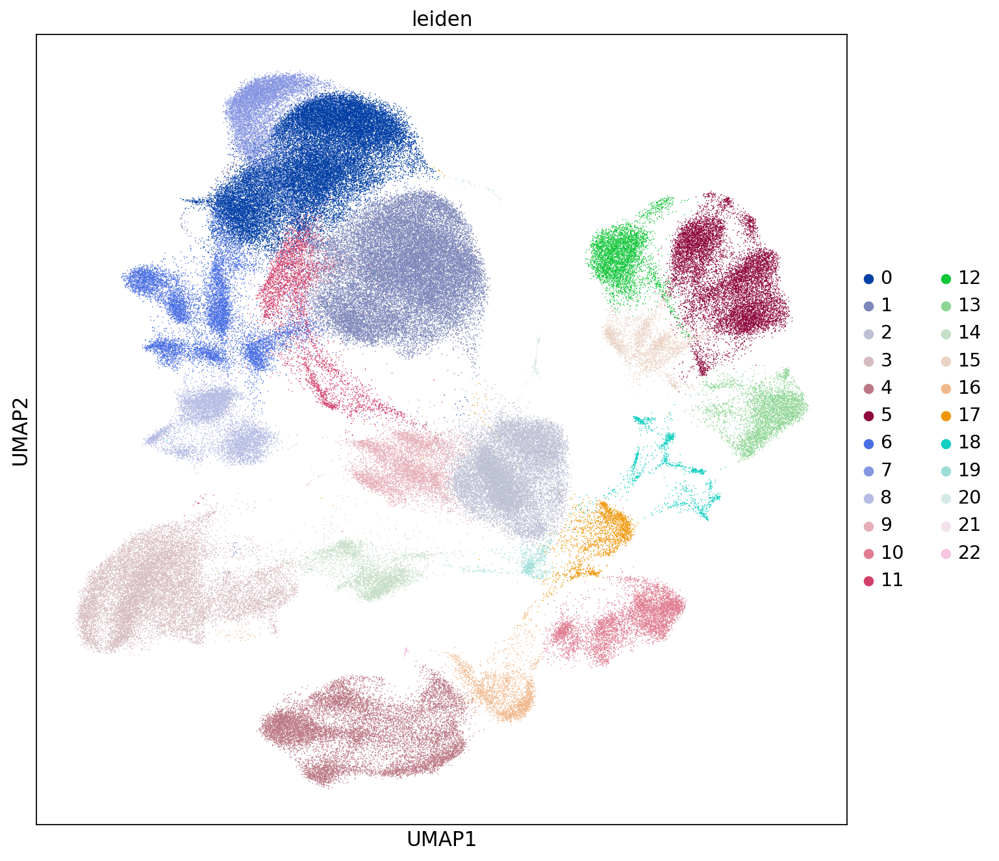

In [7]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))
for color, ax in zip(['leiden'], [ax]):
    sc.pl.umap(concat, color=color, ax=ax, show=False, return_fig=False, size=2)

In [8]:
clusts = [0, 1, 13, 16, 18, 20, 21]

In [9]:
sub_concat = dict() # put the new subsetted adata objects in a dictionary of concat
for clust in clusts:
    sub_concat[str(clust)] = concat[concat.obs['leiden'] == str(clust)].copy()

In [15]:
sc.tl.leiden(sub_concat['0'], resolution=1) # subcluster them using Leiden
nr.subcluster(sub_concat['0'], resolution=0.5, restrict_to=('leiden', ['3']), key_added='leiden_R')
groupings = [[0, 1, 2, 3, 4, 5, 7, 8, 9, 10, 12, 13, 14, 15, 16]
             ]
nr.regroup(sub_concat['0'], groupings, key='leiden_R')
nr.lR_to_l(sub_concat['0'])

running Leiden clustering
    finished: found 14 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:09)
running Leiden clustering
    finished: found 17 clusters and added
    'leiden_R', the cluster labels (adata.obs, categorical) (0:00:00)
New number of clusters: 3


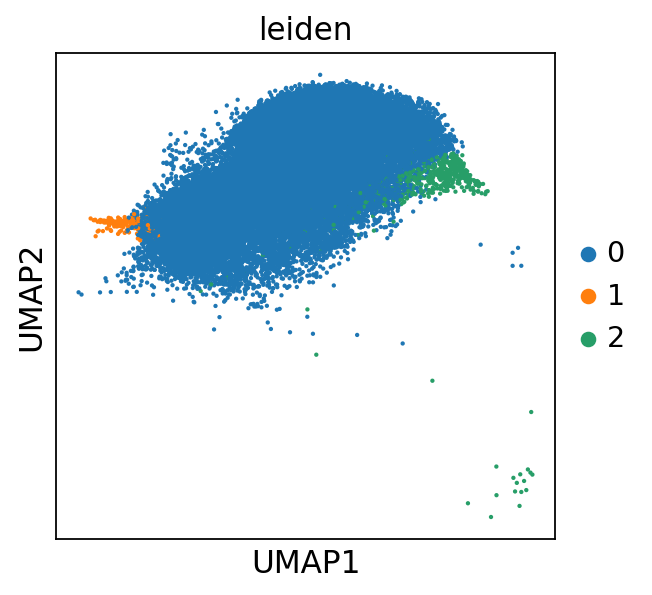

In [29]:
sc.pl.umap(sub_concat['0'], color='leiden', size=15)

In [19]:
sc.tl.leiden(sub_concat['1'], resolution=1) # subcluster them using Leiden
groupings = [[0, 1, 2, 3, 4, 5, 6, 7, 8, 11, 12]
             ]

nr.regroup(sub_concat['1'], groupings, key='leiden')

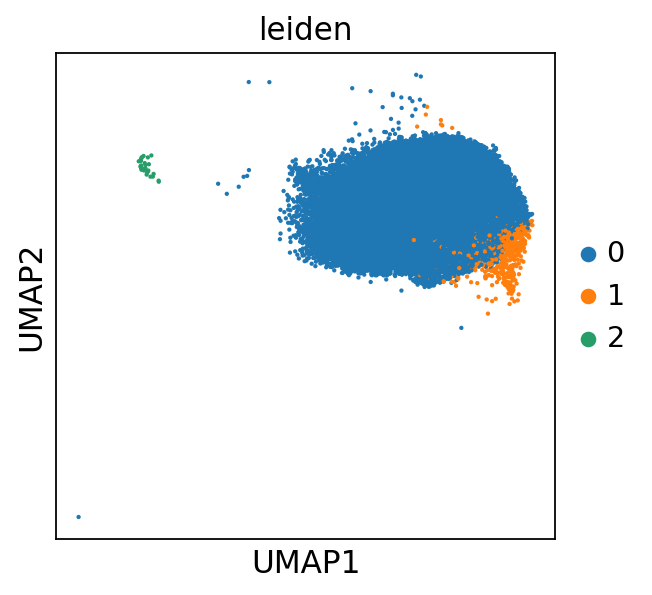

In [21]:
sc.pl.umap(sub_concat['1'], color='leiden', size=15)

running Leiden clustering
    finished: found 5 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)
New number of clusters: 2


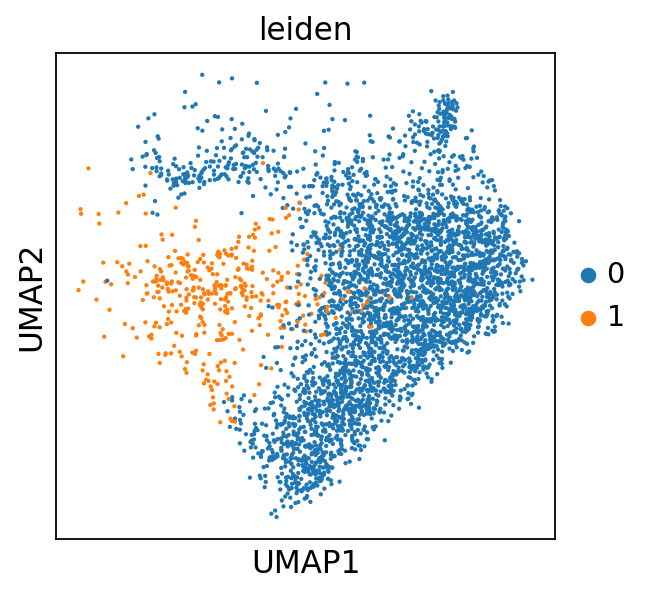

In [31]:
sc.tl.leiden(sub_concat['13'], resolution=0.3) # subcluster them using Leiden
groupings = [[0, 1, 3, 4]
             ]

nr.regroup(sub_concat['13'], groupings, key='leiden')
sc.pl.umap(sub_concat['13'], color='leiden', size=15)

running Leiden clustering
    finished: found 3 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)
New number of clusters: 2


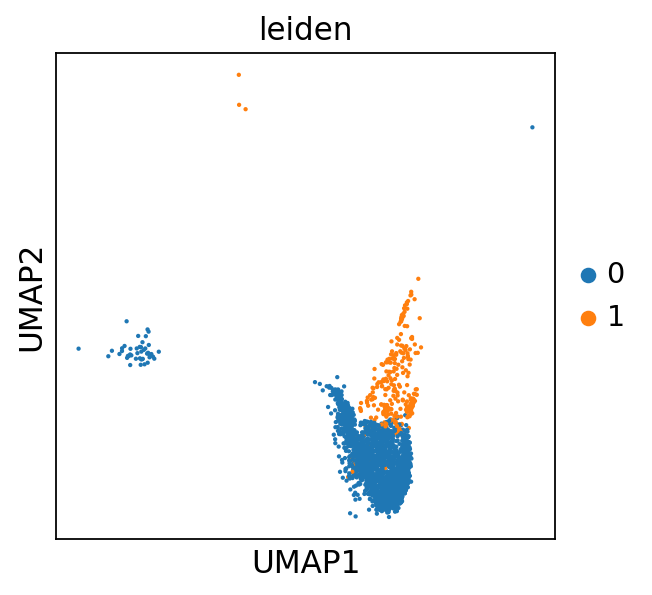

In [32]:
sc.tl.leiden(sub_concat['16'], resolution=0.2) # subcluster them using Leiden
groupings = [[0, 1]
             ]

nr.regroup(sub_concat['16'], groupings, key='leiden')
sc.pl.umap(sub_concat['16'], color='leiden', size=15)

running Leiden clustering
    finished: found 8 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)
New number of clusters: 2


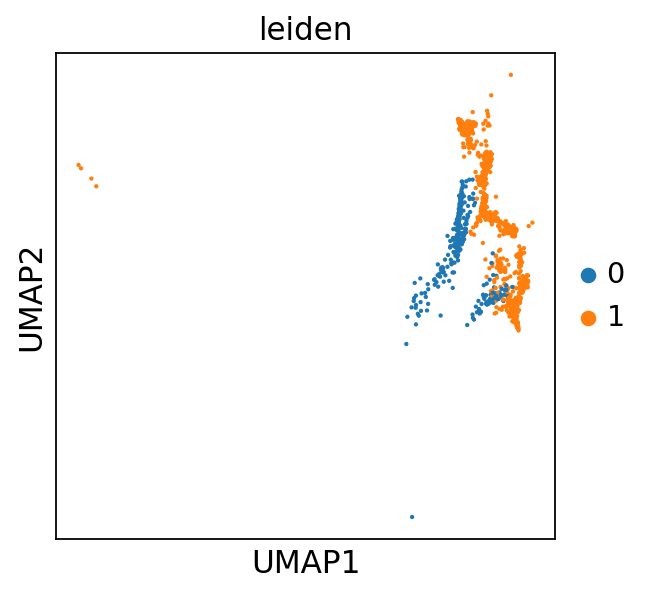

In [33]:
sc.tl.leiden(sub_concat['18'], resolution=0.3) # subcluster them using Leiden
groupings = [[0, 7],
             [1, 2, 3, 4, 5, 6],
             ]
nr.regroup(sub_concat['18'], groupings, key='leiden')
sc.pl.umap(sub_concat['18'], color='leiden', size=15)

running Leiden clustering
    finished: found 3 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)
New number of clusters: 2


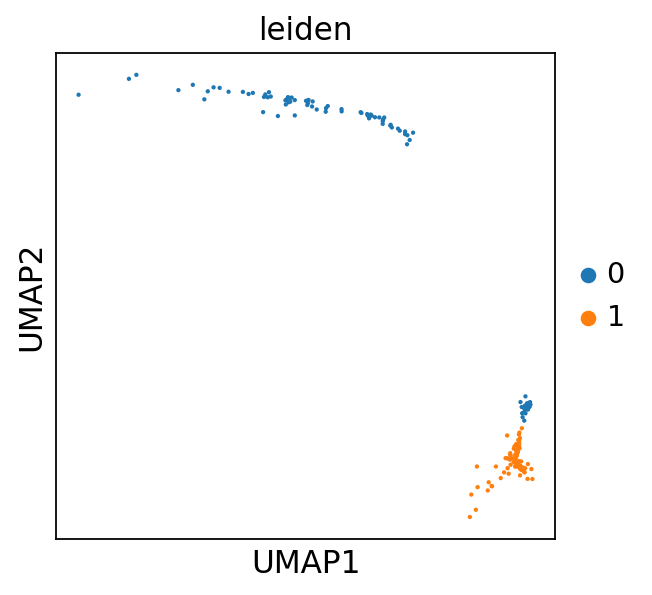

In [34]:
sc.tl.leiden(sub_concat['20'], resolution=0.2) # subcluster them using Leiden
groupings = [[1, 2]
             ]
nr.regroup(sub_concat['20'], groupings, key='leiden')
sc.pl.umap(sub_concat['20'], color='leiden', size=15)

running Leiden clustering
    finished: found 2 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


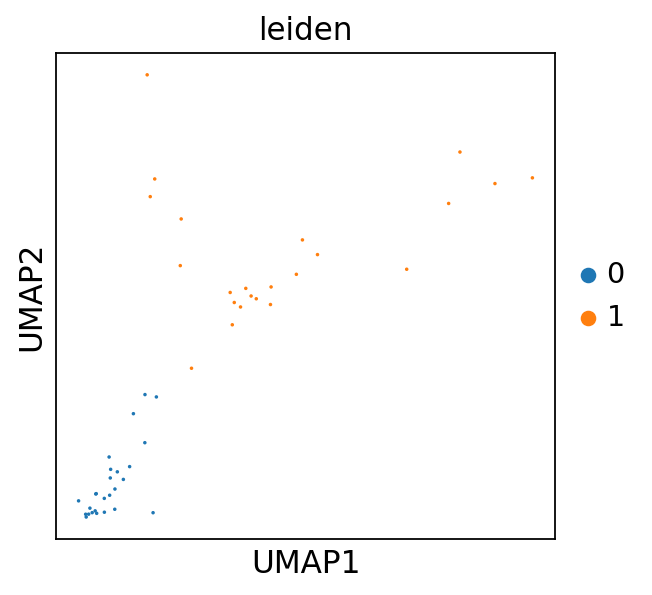

In [35]:
sc.tl.leiden(sub_concat['21'], resolution=0.2) # subcluster them using Leiden
sc.pl.umap(sub_concat['21'], color='leiden', size=10)

In [36]:
# def sub_cluster_mapper(adata, sub_adatas):
#     '''
#     This takes in the adata object and inserts a new leiden column in the `.obs`. 
    
#     This function is really convoluted and there's probably a better, simpler way to do it,
#     but it should theoretically work for any number of subclusters
#     '''
#     # ideally you'd make a copy of the adata object here, so we don't have to change the original
#     # this would be in case we want to run it multiple times, perhaps the resolutions we put in didn't subset the clusters like we had hoped
#     # and we need to run multiple times to adjust the resolution slightly
    
#     # this block is to figure out that there are two new subclusters and they should be named 8, 9
#     total_new_clusts = 0
#     old_clusts = sub_adatas.keys()
#     for sub_adata in sub_adatas:
#         total_new_clusts += sub_adatas[sub_adata].obs['leiden'].astype(int).unique().max() + 1
#     total_added_clusts = total_new_clusts - len(sub_adatas)
#     new_clust_names_start = max(adata.obs['leiden'].astype(int))+1
#     new_added_clust_names = [str(i) for i in range(new_clust_names_start,
#                                                    new_clust_names_start + total_added_clusts)]
    
#     # this block is to build a new list of leiden clusters from the old one 
#     new_leiden = list()
#     leiden_col = adata.obs['leiden'].copy()

#     # this builds the new leiden cluster list, now adding a .1, .2, etc. to each new cluster
#     for obs in leiden_col.index:
#         clust_name = leiden_col.loc[obs]
#         if clust_name not in old_clusts or sub_adatas[clust_name].obs.loc[obs, 'leiden'] == '0':
#             new_leiden.append(clust_name)
#         else:
#             new_leiden.append(clust_name + '.%s' % sub_adatas[clust_name].obs.loc[obs,'leiden'])

#     # this renames the .1, .2, etc clusters to the new, better names I came up with above (8 and 9)
#     new_leiden = pd.Series(new_leiden, index=adata.obs_names)
#     added_clusts = np.setdiff1d(new_leiden,adata.obs['leiden'])
#     new_leiden.replace(dict(zip(added_clusts, new_added_clust_names)), inplace=True)
    
#     # replace the old leiden column, must do these steps sequentially 
#     adata.obs['leiden'] = new_leiden.astype(int) # to order the clusters by number
#     adata.obs['leiden'] = new_leiden.astype(str) # to convert to string as normal
# #     adata.obs['leiden'] = new_leiden.astype('category') # don't do this, it messes things up, just let scanpy do it as it plots
#     return adata

In [37]:
concat = nr.subcluster_mapper(concat, sub_concat)

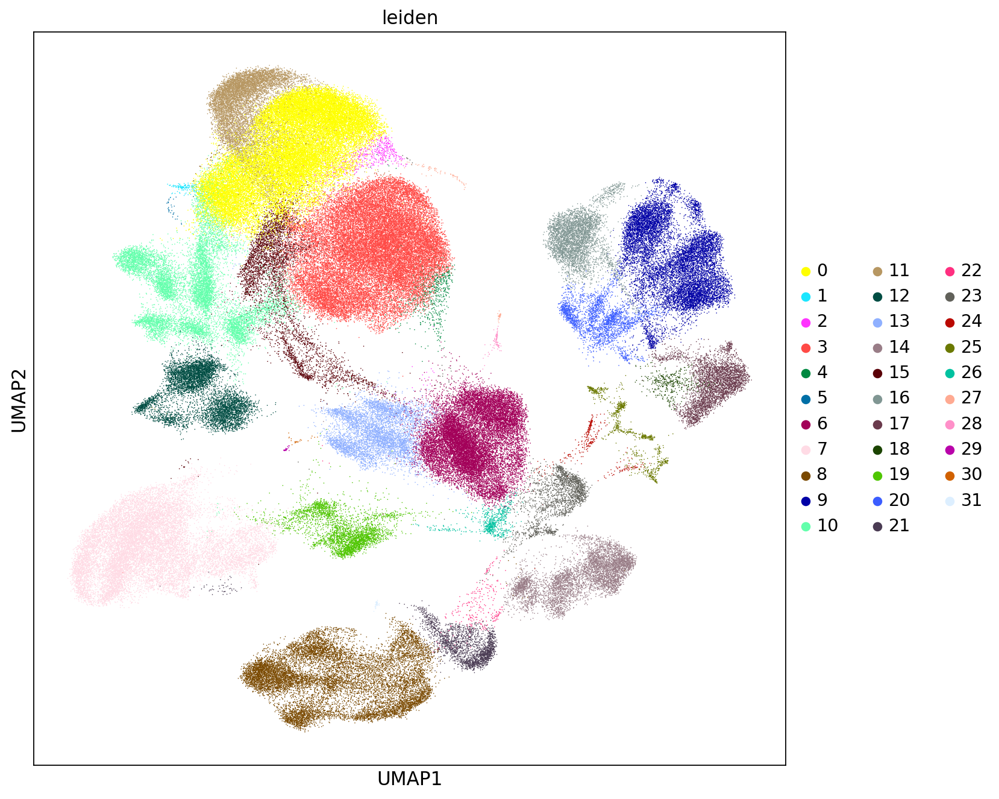

In [38]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))
for color, ax in zip(['leiden'], [ax]):
    sc.pl.umap(concat, color=color, ax=ax, show=False, return_fig=False, size=2)

0it [00:00, ?it/s]

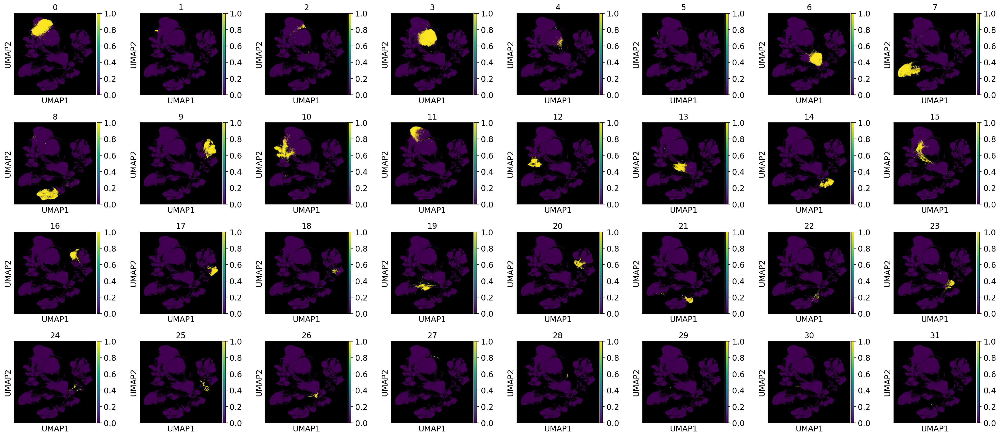

In [39]:
fig, ax = plt.subplots(4,8,figsize=(25,11))
for val, ax in tqdm(zip(concat.obs['leiden'].dtype.categories, np.ravel(ax))):
    concat.obs['val'] = concat.obs['leiden'] == val
    ax.set_facecolor('black')
    sc.pl.umap(concat,color='val', ax=ax, show=False, return_fig=False, title=val)
    concat.obs.drop(columns='val', inplace=True)
plt.tight_layout()

# Label Non-target Cells

## Mitochondrial Clusters

In [41]:
ctdict = dict()
ctdict['LOW_MITO'] = # [0, 1, 3, 4, 5, 6, 7, 8, 12, 13, 16, 20, 21, 22, 23, 24, 25, 26, 29]
ctdict['HI_MITO'] = # [2, 9, 10, 11, 14, 15, 18, 19, 27, 28, 30, 31]
ctdict['SOUP'] = # [17]
concat.obs['ct1'] = concat.obs['leiden']
for ct in ctdict:
    for clust in ctdict[ct]:
        concat.obs['ct1'].replace(str(clust), ct, regex=True, inplace=True)
concat.obs['ct1'] = concat.obs['ct1'].astype('category')

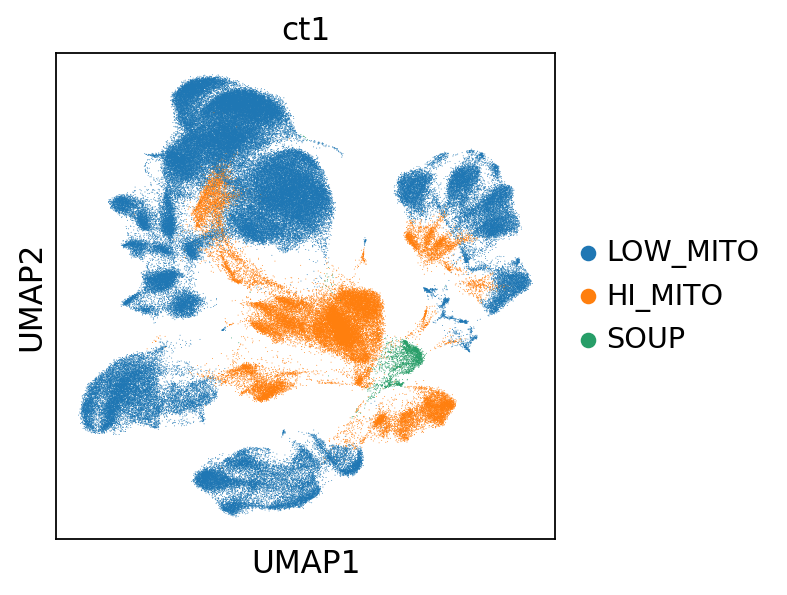

In [42]:
sc.pl.umap(concat,color=['ct1'])

## Contamination Clusters

I separated out some of the T cells. Some seem to be platelet/low count/mito clusters, towards the right side and stretching towards the middle. But I just wanted to check the ones on the other side, and I'm glad I did! They're these Th2 cells that are clustering out separately from everything else, marked by the three genes below. 

In [40]:
features = ['HPGDS', 'PTGDR2', 'CDO1'
           ]

0it [00:00, ?it/s]

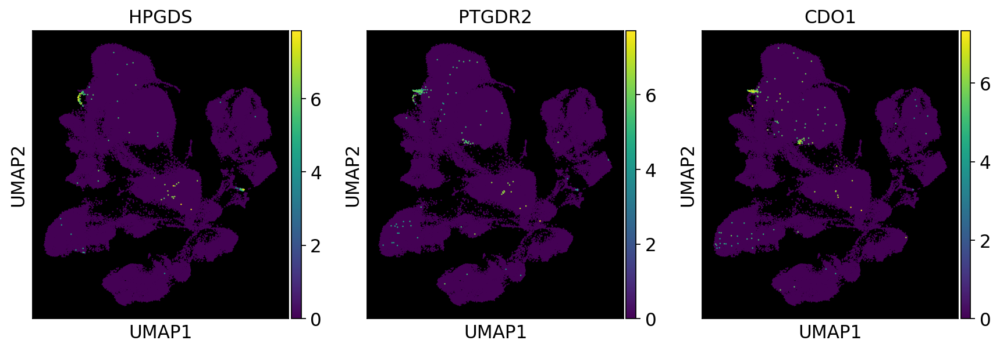

In [41]:
fig, ax = plt.subplots(1, 3, figsize=(11, 4))
for ax, f in tqdm(zip(np.ravel(ax), features)):
    ax.set_facecolor('black')
    sc.pl.umap(concat, color=f, ax=ax,show=False, return_fig=False, size=5, use_raw=True)
plt.tight_layout()

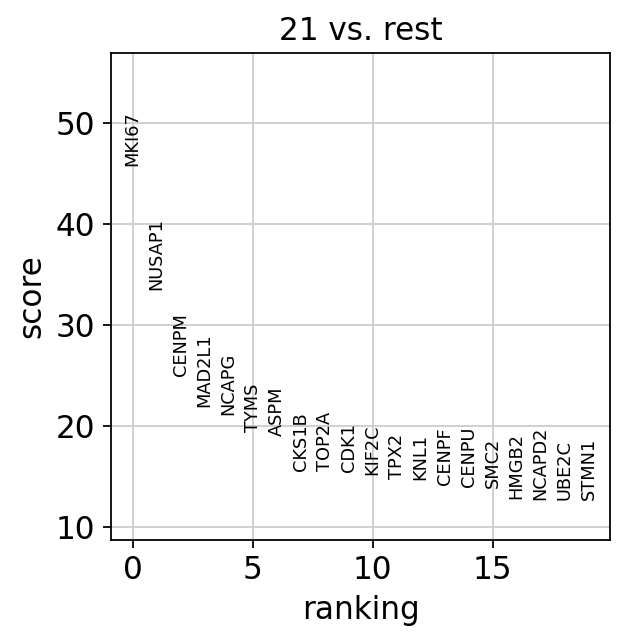

In [45]:
sc.settings.verbosity = 0 
warnings.filterwarnings('ignore')
sc.tl.rank_genes_groups(concat, groupby='leiden', groups=['21'], n_genes=50)
warnings.filterwarnings('default')
sc.pl.rank_genes_groups(concat, ncols=5, n_genes=20)
sc.settings.verbosity = 4

Looks like we caught a very very small number of cells right in the middle of mitosis. Pretty cool.

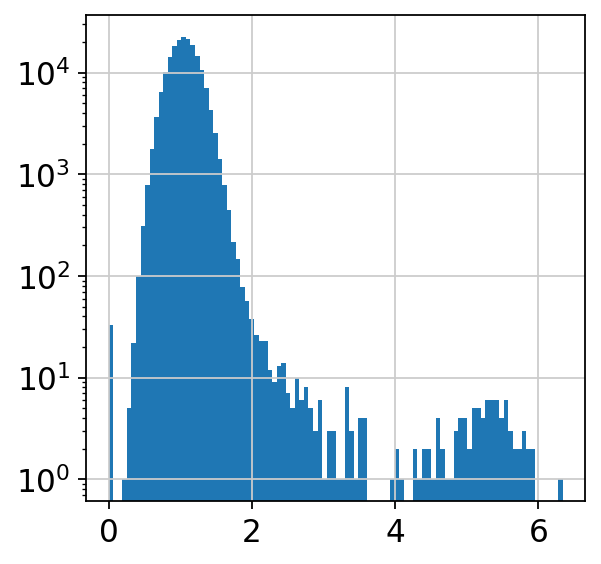

In [44]:
plt.hist(concat.raw.obs_vector('CD235a_b|GYPA_GYPB'), bins=100);
plt.yscale('log')

In [46]:
ct2 = list()
gyp_counts = pd.Series(index=concat.obs_names, data=concat.raw.obs_vector('CD235a_b|GYPA_GYPB'))
for obs_name in tqdm(concat.obs_names):
    if concat.obs.loc[obs_name,'leiden'] in (['20', '30']):
        ct2.append('CONTAM') # PLATELETS
    elif ((concat.obs.loc[obs_name,'leiden'] in ['24', '25']) or 
          (concat.obs.loc[obs_name,'adts_n_counts'] < 1000) or
          (concat.obs.loc[obs_name,'mrna_n_counts'] < 700)):
        ct2.append('CONTAM') # LOW_COUNTS
    elif gyp_counts.loc[obs_name] > 4:
        ct2.append('CONTAM') # RBCs
    else:
        ct2.append('NORMAL')

In [47]:
concat.obs['ct2'] = ct2

... storing 'ct2' as categorical


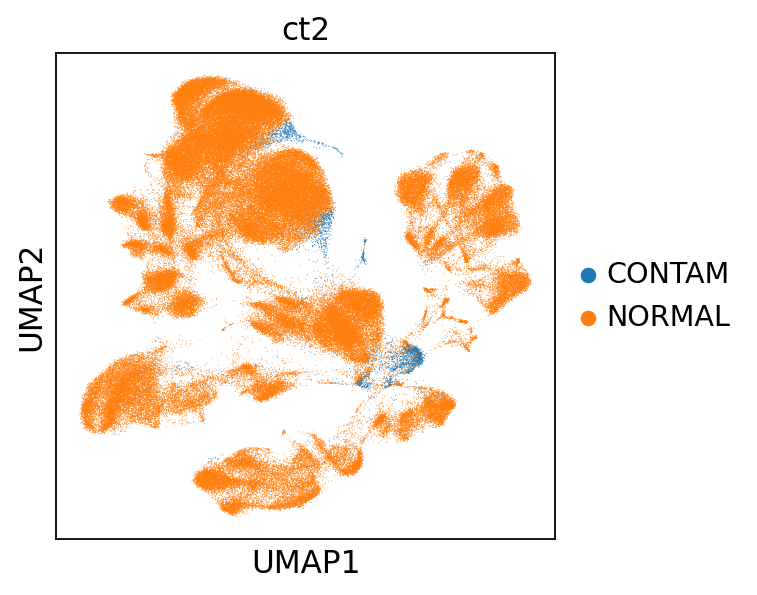

In [48]:
sc.pl.umap(concat,color=['ct2'])

# Export

In [5]:
path = prefix_mrna + 'h5ads/concat_1.h5ad'

# concat.write_h5ad(path)
concat = sc.read_h5ad(path)

I export `ct1` and `ct2` to identify mitochondrial content cells and remove them in `process2.ipynb`.

In [50]:
path = prefix_mrna + 'vals/mito.csv'
concat.obs[['ct1', 'ct2']].to_csv(path)